# NLP-based Data Science - Comparison of machine learning models using the example of text classification of twitter data

## Introduction
This notebook demonstrates the process of exploratory data analysis on text data. The information gathered from the EDA will be used to create new features and create better performing machine learning models. In this notebook I will specifically look at things like the word length and tweet length. I will also use dimensionality reduction techniques to take a look at the data in 2D and 3D space.

## 1. Imports

In [1]:
import re
import string
import nltk
import Emoticons
import Chatwords
import textstat

import pandas as pd
import numpy as np
import scipy.stats as stats

import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
from plotly.subplots import make_subplots

from sklearn import svm
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer, HashingVectorizer
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import cohen_kappa_score, accuracy_score, confusion_matrix, plot_confusion_matrix
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB, MultinomialNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.manifold import TSNE
from statsmodels.stats.inter_rater import fleiss_kappa

from sklearn_pandas import DataFrameMapper

from nltk.corpus import stopwords, wordnet
from nltk.stem.porter import PorterStemmer
from nltk.stem import WordNetLemmatizer

from spellchecker import SpellChecker

from textblob import TextBlob

from tqdm.auto import tqdm 
#import cudf

from wordcloud import WordCloud
import matplotlib.pyplot as plt
%matplotlib inline

## 2. Loading the data and preparing the dataframe for further analysis 

### 2.1 Loading the Data

In [2]:
df = pd.read_csv("labeled_data.csv")
#df_test_data = pd.read_excel("Covid_tweet_data_for_annotation.xlsx")
df.drop(columns=["Unnamed: 0"], inplace = True)
df

,count,hate_speech,offensive_language,neither,class,tweet
0,3,0,0,3,2,!!! RT @mayasolovely: As a woman you shouldn't...
1,3,0,3,0,1,!!!!! RT @mleew17: boy dats cold...tyga dwn ba...
2,3,0,3,0,1,!!!!!!! RT @UrKindOfBrand Dawg!!!! RT @80sbaby...
3,3,0,2,1,1,!!!!!!!!! RT @C_G_Anderson: @viva_based she lo...
4,6,0,6,0,1,!!!!!!!!!!!!! RT @ShenikaRoberts: The shit you...
...,...,...,...,...,...,...
24778,3,0,2,1,1,you's a muthaf***in lie &#8220;@LifeAsKing: @2...
24779,3,0,1,2,2,"you've gone and broke the wrong heart baby, an..."
24780,3,0,3,0,1,young buck wanna eat!!.. dat nigguh like I ain...
24781,6,0,6,0,1,youu got wild bitches tellin you lies


### 2.2 Grouping offensive language + hatespeech
The original paper where this dataset is from categorizes all tweets in the three classes "normal", "offensive language" and "hate speech". Since hate speech has lots of different definitions it is very difficult even for humans to clearly determine whether a tweet should be labeled as hate speech or not. Therefore this project will focus on the detection of offensive language in general. To be able to use the whole dataset I will group all tweets in this dataset labeled as "offensive language" or "hate speech" together and give it the class "Offensive language+".

In [3]:
df["grouped_class_descr"] = df["class"].apply(lambda x: "Offensive language+" if x == 0 or x == 1 else "Normal")
df["grouped_class"] = df["class"].apply(lambda x: 1 if x == 0 or x == 1 else 0)

print(df["grouped_class"].value_counts())
print("-"*40)
print(df["grouped_class_descr"].value_counts())
df.head()

1    20620
0     4163
Name: grouped_class, dtype: int64
----------------------------------------
Offensive language+    20620
Normal                  4163
Name: grouped_class_descr, dtype: int64


,count,hate_speech,offensive_language,neither,class,tweet,grouped_class_descr,grouped_class
0,3,0,0,3,2,!!! RT @mayasolovely: As a woman you shouldn't...,Normal,0
1,3,0,3,0,1,!!!!! RT @mleew17: boy dats cold...tyga dwn ba...,Offensive language+,1
2,3,0,3,0,1,!!!!!!! RT @UrKindOfBrand Dawg!!!! RT @80sbaby...,Offensive language+,1
3,3,0,2,1,1,!!!!!!!!! RT @C_G_Anderson: @viva_based she lo...,Offensive language+,1
4,6,0,6,0,1,!!!!!!!!!!!!! RT @ShenikaRoberts: The shit you...,Offensive language+,1


## 3. Data preprocessing
In this step I am going to preprocess the raw tweets in order to make the data more uniformly and therefore easier to process by machine learning models. <br><br>I will apply the following preprocessing steps in the following order:
1. Making all words lowercase
2. Cleaning the tweets --> removing mentions, hashtags, urls and retweets
3. Converting Emoticons to text
4. Removing all newlines (\n)
5. Converting all chat words to full words
6. Removing all digits
7. Removing punctuation 
8. Spelling correction
9. Removing stopwords
10. WordNetLemmatizer to group words together to it's basic form



I choose this order of preprocessing steps for several reasons. For step two & three the tweet has to be in raw format in order to work properly. For example urls can only be removed if no characters of the url are deleted. After step three things like newlines and digits will be removed. It is important that the chatword conversion will be done before the removal of digits and punctuation because chatwords include digits and special characters which will be removed after step six and seven. The next step after the removal of punctuation is the spelling correction. In this case it makes sense to do the spelling correction before the stopword removal because some words might be corrected to a stop word in the process of spelling correction. After step eight and nine the last step in the preprocessing chain will be the use of the wordnetlemmatizer. It is important to do this step at the end of the preprocessing chain because it might benefit from earlier steps like the spelling correction. 

### 3.1 Converting all words to lowercase

In [4]:
df["tweet"] = df["tweet"].str.lower()
df.head(25)

,count,hate_speech,offensive_language,neither,class,tweet,grouped_class_descr,grouped_class
0,3,0,0,3,2,!!! rt @mayasolovely: as a woman you shouldn't...,Normal,0
1,3,0,3,0,1,!!!!! rt @mleew17: boy dats cold...tyga dwn ba...,Offensive language+,1
2,3,0,3,0,1,!!!!!!! rt @urkindofbrand dawg!!!! rt @80sbaby...,Offensive language+,1
3,3,0,2,1,1,!!!!!!!!! rt @c_g_anderson: @viva_based she lo...,Offensive language+,1
4,6,0,6,0,1,!!!!!!!!!!!!! rt @shenikaroberts: the shit you...,Offensive language+,1
5,3,1,2,0,1,"!!!!!!!!!!!!!!!!!!""@t_madison_x: the shit just...",Offensive language+,1
6,3,0,3,0,1,"!!!!!!""@__brighterdays: i can not just sit up ...",Offensive language+,1
7,3,0,3,0,1,!!!!&#8220;@selfiequeenbri: cause i'm tired of...,Offensive language+,1
8,3,0,3,0,1,""" &amp; you might not get ya bitch back &amp; ...",Offensive language+,1
9,3,1,2,0,1,""" @rhythmixx_ :hobbies include: fighting maria...",Offensive language+,1


### 3.2 Basic text cleaning
**Removing:**
- Mentions
- Hashtags
- Retweets
- URL`s

In [5]:
# Get all the deleted characters and word
def get_deleted_text(text):
    """Custom function to get the delted text which is deleted using the clean_text function"""
    return {
        "removed mentions": re.findall('@[A-Za-z0-9]+',text), # getting mentions
        "removed hashtags": re.findall('#',text), # getting hashtags
        "removed retweets": re.findall('RT[\s]+',text), # getting retweets
        "removed urls": re.findall('https?:\/\/\S+',text) # getting urls
    }

# Delete all mentions, hashtags, urls and retweets
def clean_text(text):
    """Custom function to delete mentions, hashtags, urls and retweets"""
    text= re.sub('@[A-Za-z0-9]+','',text ) # removing mentions
    text= re.sub("#",'',text) # removing hashtags
    text= re.sub('rt[\s]+','',text) # removing retweets
    text= re.sub('https?:\/\/\S+','',text) # removing urls
    return text

df["deleted_text"] = df["tweet"].apply(get_deleted_text)
df["tweet"] = df["tweet"].apply(clean_text)
df.head(25)

,count,hate_speech,offensive_language,neither,class,tweet,grouped_class_descr,grouped_class,deleted_text
0,3,0,0,3,2,!!! : as a woman you shouldn't complain about ...,Normal,0,"{'removed mentions': ['@mayasolovely'], 'remov..."
1,3,0,3,0,1,!!!!! : boy dats cold...tyga dwn bad for cuffi...,Offensive language+,1,"{'removed mentions': ['@mleew17'], 'removed ha..."
2,3,0,3,0,1,!!!!!!! dawg!!!! : you ever fuck a bitch and s...,Offensive language+,1,"{'removed mentions': ['@urkindofbrand', '@80sb..."
3,3,0,2,1,1,!!!!!!!!! _g_anderson: _based she look like a ...,Offensive language+,1,"{'removed mentions': ['@c', '@viva'], 'removed..."
4,6,0,6,0,1,!!!!!!!!!!!!! : the shit you hear about me mig...,Offensive language+,1,"{'removed mentions': ['@shenikaroberts'], 'rem..."
5,3,1,2,0,1,"!!!!!!!!!!!!!!!!!!""_madison_x: the shit just b...",Offensive language+,1,"{'removed mentions': ['@t'], 'removed hashtags..."
6,3,0,3,0,1,"!!!!!!""@__brighterdays: i can not just sit up ...",Offensive language+,1,"{'removed mentions': [], 'removed hashtags': [..."
7,3,0,3,0,1,!!!!&8220;: cause i'm tired of you big bitches...,Offensive language+,1,"{'removed mentions': ['@selfiequeenbri'], 'rem..."
8,3,0,3,0,1,""" &amp; you might not get ya bitch back &amp; ...",Offensive language+,1,"{'removed mentions': [], 'removed hashtags': [..."
9,3,1,2,0,1,""" _ :hobbies include: fighting mariam""\n\nbitch",Offensive language+,1,"{'removed mentions': ['@rhythmixx'], 'removed ..."


### 3.3 Conversion of Emoticons to text

In [7]:
# source: https://github.com/NeelShah18/emot/blob/master/emot/emo_unicode.py

EMOTICONS = Emoticons.EMOTICONS

def convert_emoticons(text):
    """Custom function to convert Emoticons to text"""
    for emot in EMOTICONS.keys():
        emot_modified = f" {emot} "
        #print(emot_modified, len(emot_modified))
        text = re.sub(emot_modified, " " + " ".join(EMOTICONS[emot].replace(",","").split()).lower() + " ", text)
    return text

df["tweet"] = df["tweet"].apply(convert_emoticons)
df.head(25)

,count,hate_speech,offensive_language,neither,class,tweet,grouped_class_descr,grouped_class,deleted_text
0,3,0,0,3,2,!!! : as a woman you shouldn't complain about ...,Normal,0,"{'removed mentions': ['@mayasolovely'], 'remov..."
1,3,0,3,0,1,!!!!! : boy dats cold...tyga dwn bad for cuffi...,Offensive language+,1,"{'removed mentions': ['@mleew17'], 'removed ha..."
2,3,0,3,0,1,!!!!!!! dawg!!!! : you ever fuck a bitch and s...,Offensive language+,1,"{'removed mentions': ['@urkindofbrand', '@80sb..."
3,3,0,2,1,1,!!!!!!!!! _g_anderson: _based she look like a ...,Offensive language+,1,"{'removed mentions': ['@c', '@viva'], 'removed..."
4,6,0,6,0,1,!!!!!!!!!!!!! : the shit you hear about me mig...,Offensive language+,1,"{'removed mentions': ['@shenikaroberts'], 'rem..."
5,3,1,2,0,1,"!!!!!!!!!!!!!!!!!!""_madison_x: the shit just b...",Offensive language+,1,"{'removed mentions': ['@t'], 'removed hashtags..."
6,3,0,3,0,1,"!!!!!!""@__brighterdays: i can not just sit up ...",Offensive language+,1,"{'removed mentions': [], 'removed hashtags': [..."
7,3,0,3,0,1,!!!!&8220;: cause i'm tired of you big bitches...,Offensive language+,1,"{'removed mentions': ['@selfiequeenbri'], 'rem..."
8,3,0,3,0,1,""" &amp; you might not get ya bitch back &amp; ...",Offensive language+,1,"{'removed mentions': [], 'removed hashtags': [..."
9,3,1,2,0,1,""" _ :hobbies include: fighting mariam""\n\nbitch",Offensive language+,1,"{'removed mentions': ['@rhythmixx'], 'removed ..."


### 3.4 Removal of newlines (\n)

In [8]:
def remove_new_lines(text):
    text = re.sub(r"\n", " ", text)
    return text

df["tweet"] = df["tweet"].apply(remove_new_lines)
df.head(25)

,count,hate_speech,offensive_language,neither,class,tweet,grouped_class_descr,grouped_class,deleted_text
0,3,0,0,3,2,!!! : as a woman you shouldn't complain about ...,Normal,0,"{'removed mentions': ['@mayasolovely'], 'remov..."
1,3,0,3,0,1,!!!!! : boy dats cold...tyga dwn bad for cuffi...,Offensive language+,1,"{'removed mentions': ['@mleew17'], 'removed ha..."
2,3,0,3,0,1,!!!!!!! dawg!!!! : you ever fuck a bitch and s...,Offensive language+,1,"{'removed mentions': ['@urkindofbrand', '@80sb..."
3,3,0,2,1,1,!!!!!!!!! _g_anderson: _based she look like a ...,Offensive language+,1,"{'removed mentions': ['@c', '@viva'], 'removed..."
4,6,0,6,0,1,!!!!!!!!!!!!! : the shit you hear about me mig...,Offensive language+,1,"{'removed mentions': ['@shenikaroberts'], 'rem..."
5,3,1,2,0,1,"!!!!!!!!!!!!!!!!!!""_madison_x: the shit just b...",Offensive language+,1,"{'removed mentions': ['@t'], 'removed hashtags..."
6,3,0,3,0,1,"!!!!!!""@__brighterdays: i can not just sit up ...",Offensive language+,1,"{'removed mentions': [], 'removed hashtags': [..."
7,3,0,3,0,1,!!!!&8220;: cause i'm tired of you big bitches...,Offensive language+,1,"{'removed mentions': ['@selfiequeenbri'], 'rem..."
8,3,0,3,0,1,""" &amp; you might not get ya bitch back &amp; ...",Offensive language+,1,"{'removed mentions': [], 'removed hashtags': [..."
9,3,1,2,0,1,""" _ :hobbies include: fighting mariam"" bitch",Offensive language+,1,"{'removed mentions': ['@rhythmixx'], 'removed ..."


### 3.5 Conversion of chat words

In [9]:
# Processing the Chat words from Chatwords.py
chat_words_str = Chatwords.chat_words_str
chat_words_map_dict = {}
chat_words_list = []
for line in chat_words_str.split("\n"):
    if line != "":
        cw = line.split("=")[0]
        cw_expanded = line.split("=")[1].lower()
        chat_words_list.append(cw)
        chat_words_map_dict[cw] = cw_expanded
chat_words_list = set(chat_words_list)
#print(chat_words_map_dict)

def convert_chat_words(text):
    """Custom function that converts Chatwords into normal words"""
    new_text = []
    for w in text.split():
        if w.upper() in chat_words_list:
            new_text.append(chat_words_map_dict[w.upper()])
        else:
            new_text.append(w)
    return " ".join(new_text)

df["tweet"] = df["tweet"].apply(convert_chat_words)
df.head(25)

,count,hate_speech,offensive_language,neither,class,tweet,grouped_class_descr,grouped_class,deleted_text
0,3,0,0,3,2,!!! : as a woman you shouldn't complain about ...,Normal,0,"{'removed mentions': ['@mayasolovely'], 'remov..."
1,3,0,3,0,1,!!!!! : boy dats cold...tyga dwn bad for cuffi...,Offensive language+,1,"{'removed mentions': ['@mleew17'], 'removed ha..."
2,3,0,3,0,1,!!!!!!! dawg!!!! : you ever fuck a bitch and s...,Offensive language+,1,"{'removed mentions': ['@urkindofbrand', '@80sb..."
3,3,0,2,1,1,!!!!!!!!! _g_anderson: _based she look like a ...,Offensive language+,1,"{'removed mentions': ['@c', '@viva'], 'removed..."
4,6,0,6,0,1,!!!!!!!!!!!!! : the shit you hear about me mig...,Offensive language+,1,"{'removed mentions': ['@shenikaroberts'], 'rem..."
5,3,1,2,0,1,"!!!!!!!!!!!!!!!!!!""_madison_x: the shit just b...",Offensive language+,1,"{'removed mentions': ['@t'], 'removed hashtags..."
6,3,0,3,0,1,"!!!!!!""@__brighterdays: i can not just sit up ...",Offensive language+,1,"{'removed mentions': [], 'removed hashtags': [..."
7,3,0,3,0,1,!!!!&8220;: cause i'm tired of you big bitches...,Offensive language+,1,"{'removed mentions': ['@selfiequeenbri'], 'rem..."
8,3,0,3,0,1,""" &amp; you might not get ya bitch back &amp; ...",Offensive language+,1,"{'removed mentions': [], 'removed hashtags': [..."
9,3,1,2,0,1,""" _ :hobbies include: fighting mariam"" bitch",Offensive language+,1,"{'removed mentions': ['@rhythmixx'], 'removed ..."


### 3.6 Removal of all digits

In [10]:
def remove_digits(text):
    text = re.sub("\d", " ", text)
    return text

df["tweet"] = df["tweet"].apply(remove_digits)
df.head(25)

,count,hate_speech,offensive_language,neither,class,tweet,grouped_class_descr,grouped_class,deleted_text
0,3,0,0,3,2,!!! : as a woman you shouldn't complain about ...,Normal,0,"{'removed mentions': ['@mayasolovely'], 'remov..."
1,3,0,3,0,1,!!!!! : boy dats cold...tyga dwn bad for cuffi...,Offensive language+,1,"{'removed mentions': ['@mleew17'], 'removed ha..."
2,3,0,3,0,1,!!!!!!! dawg!!!! : you ever fuck a bitch and s...,Offensive language+,1,"{'removed mentions': ['@urkindofbrand', '@80sb..."
3,3,0,2,1,1,!!!!!!!!! _g_anderson: _based she look like a ...,Offensive language+,1,"{'removed mentions': ['@c', '@viva'], 'removed..."
4,6,0,6,0,1,!!!!!!!!!!!!! : the shit you hear about me mig...,Offensive language+,1,"{'removed mentions': ['@shenikaroberts'], 'rem..."
5,3,1,2,0,1,"!!!!!!!!!!!!!!!!!!""_madison_x: the shit just b...",Offensive language+,1,"{'removed mentions': ['@t'], 'removed hashtags..."
6,3,0,3,0,1,"!!!!!!""@__brighterdays: i can not just sit up ...",Offensive language+,1,"{'removed mentions': [], 'removed hashtags': [..."
7,3,0,3,0,1,!!!!& ;: cause i'm tired of you big bitches...,Offensive language+,1,"{'removed mentions': ['@selfiequeenbri'], 'rem..."
8,3,0,3,0,1,""" &amp; you might not get ya bitch back &amp; ...",Offensive language+,1,"{'removed mentions': [], 'removed hashtags': [..."
9,3,1,2,0,1,""" _ :hobbies include: fighting mariam"" bitch",Offensive language+,1,"{'removed mentions': ['@rhythmixx'], 'removed ..."


In [11]:
df["tweet"][23]

'" fuck no that bitch dont even suck dick " &      ;&      ;&      ; the kermit videos bout to fuck ig up'

### 3.7 Removal of Punctuation
**The following Characters count as punctuation:**
<br>
!"#$%&'()*+,-./:;<=>?@[\]^_`{|}~

In [12]:
# Remove punctuation
#print(string.punctuation)
def remove_punctuation(text):
    """Custom function to remove punctuation"""
    return text.translate(str.maketrans('', '', string.punctuation))

df["tweet"] = df["tweet"].apply(remove_punctuation)
df.head(25)

,count,hate_speech,offensive_language,neither,class,tweet,grouped_class_descr,grouped_class,deleted_text
0,3,0,0,3,2,as a woman you shouldnt complain about clean...,Normal,0,"{'removed mentions': ['@mayasolovely'], 'remov..."
1,3,0,3,0,1,boy dats coldtyga dwn bad for cuffin dat hoe...,Offensive language+,1,"{'removed mentions': ['@mleew17'], 'removed ha..."
2,3,0,3,0,1,dawg you ever fuck a bitch and she stato cry...,Offensive language+,1,"{'removed mentions': ['@urkindofbrand', '@80sb..."
3,3,0,2,1,1,ganderson based she look like a tranny,Offensive language+,1,"{'removed mentions': ['@c', '@viva'], 'removed..."
4,6,0,6,0,1,the shit you hear about me might be true or ...,Offensive language+,1,"{'removed mentions': ['@shenikaroberts'], 'rem..."
5,3,1,2,0,1,madisonx the shit just blows meclaim you so fa...,Offensive language+,1,"{'removed mentions': ['@t'], 'removed hashtags..."
6,3,0,3,0,1,brighterdays i can not just sit up and hate on...,Offensive language+,1,"{'removed mentions': [], 'removed hashtags': [..."
7,3,0,3,0,1,cause im tired of you big bitches coming ...,Offensive language+,1,"{'removed mentions': ['@selfiequeenbri'], 'rem..."
8,3,0,3,0,1,amp you might not get ya bitch back amp thats...,Offensive language+,1,"{'removed mentions': [], 'removed hashtags': [..."
9,3,1,2,0,1,hobbies include fighting mariam bitch,Offensive language+,1,"{'removed mentions': ['@rhythmixx'], 'removed ..."


### 2.8 Spelling correction

In [13]:

tqdm.pandas()
spell = SpellChecker()
def correct_spellings(text):
    corrected_text = []
    misspelled_words = spell.unknown(text.split())
    for word in text.split():
        if word in misspelled_words:
            corrected_text.append(spell.correction(word))
        else:
            corrected_text.append(word)
    return " ".join(corrected_text)

df["tweet"] = df["tweet"].progress_apply(correct_spellings)
df.head(25)


'\ntqdm.pandas()\nspell = SpellChecker()\ndef correct_spellings(text):\n    corrected_text = []\n    misspelled_words = spell.unknown(text.split())\n    for word in text.split():\n        if word in misspelled_words:\n            corrected_text.append(spell.correction(word))\n        else:\n            corrected_text.append(word)\n    return " ".join(corrected_text)\n\ndf["tweet"] = df["tweet"].progress_apply(correct_spellings)\ndf.head(25)\n'

### 2.9 Removal of stopwords

In [14]:
STOPWORDS = set(stopwords.words('english'))
def remove_stopwords(text):
    """custom function to remove the stopwords"""
    return " ".join([word for word in str(text).split() if word not in STOPWORDS])

df["tweet"] = df["tweet"].apply(remove_stopwords)
df.head(25)

,count,hate_speech,offensive_language,neither,class,tweet,grouped_class_descr,grouped_class,deleted_text
0,3,0,0,3,2,woman shouldnt complain cleaning house amp man...,Normal,0,"{'removed mentions': ['@mayasolovely'], 'remov..."
1,3,0,3,0,1,boy dats coldtyga dwn bad cuffin dat hoe st place,Offensive language+,1,"{'removed mentions': ['@mleew17'], 'removed ha..."
2,3,0,3,0,1,dawg ever fuck bitch stato cry confused shit,Offensive language+,1,"{'removed mentions': ['@urkindofbrand', '@80sb..."
3,3,0,2,1,1,ganderson based look like tranny,Offensive language+,1,"{'removed mentions': ['@c', '@viva'], 'removed..."
4,6,0,6,0,1,shit hear might true might faker bitch told ya,Offensive language+,1,"{'removed mentions': ['@shenikaroberts'], 'rem..."
5,3,1,2,0,1,madisonx shit blows meclaim faithful somebody ...,Offensive language+,1,"{'removed mentions': ['@t'], 'removed hashtags..."
6,3,0,3,0,1,brighterdays sit hate another bitch got much s...,Offensive language+,1,"{'removed mentions': [], 'removed hashtags': [..."
7,3,0,3,0,1,cause im tired big bitches coming us skinny girls,Offensive language+,1,"{'removed mentions': ['@selfiequeenbri'], 'rem..."
8,3,0,3,0,1,amp might get ya bitch back amp thats,Offensive language+,1,"{'removed mentions': [], 'removed hashtags': [..."
9,3,1,2,0,1,hobbies include fighting mariam bitch,Offensive language+,1,"{'removed mentions': ['@rhythmixx'], 'removed ..."


### 2.10 WordNet Lemmatizer

In [15]:
lemmatizer = WordNetLemmatizer()
wordnet_map = {"N":wordnet.NOUN, "V":wordnet.VERB, "J":wordnet.ADJ, "R":wordnet.ADV}
def lemmatize_words(text):
    """Function for lemmatization"""
    pos_tagged_text = nltk.pos_tag(text.split())
    return " ".join([lemmatizer.lemmatize(word, wordnet_map.get(pos[0], wordnet.NOUN)) for word, pos in pos_tagged_text])

df["tweet"] = df["tweet"].apply(lemmatize_words)
df.head(25)

,count,hate_speech,offensive_language,neither,class,tweet,grouped_class_descr,grouped_class,deleted_text
0,3,0,0,3,2,woman shouldnt complain cleaning house amp man...,Normal,0,"{'removed mentions': ['@mayasolovely'], 'remov..."
1,3,0,3,0,1,boy dat coldtyga dwn bad cuffin dat hoe st place,Offensive language+,1,"{'removed mentions': ['@mleew17'], 'removed ha..."
2,3,0,3,0,1,dawg ever fuck bitch stato cry confuse shit,Offensive language+,1,"{'removed mentions': ['@urkindofbrand', '@80sb..."
3,3,0,2,1,1,ganderson base look like tranny,Offensive language+,1,"{'removed mentions': ['@c', '@viva'], 'removed..."
4,6,0,6,0,1,shit hear might true might faker bitch tell ya,Offensive language+,1,"{'removed mentions': ['@shenikaroberts'], 'rem..."
5,3,1,2,0,1,madisonx shit blow meclaim faithful somebody s...,Offensive language+,1,"{'removed mentions': ['@t'], 'removed hashtags..."
6,3,0,3,0,1,brighterdays sit hate another bitch get much s...,Offensive language+,1,"{'removed mentions': [], 'removed hashtags': [..."
7,3,0,3,0,1,cause im tire big bitch come u skinny girl,Offensive language+,1,"{'removed mentions': ['@selfiequeenbri'], 'rem..."
8,3,0,3,0,1,amp might get ya bitch back amp thats,Offensive language+,1,"{'removed mentions': [], 'removed hashtags': [..."
9,3,1,2,0,1,hobby include fight mariam bitch,Offensive language+,1,"{'removed mentions': ['@rhythmixx'], 'removed ..."


### 3.11 Combining multiple whitespaces to one

In [16]:
def remove_whitespace(text):
    text = re.sub('\s+',' ', text)
    return text

df["tweet"] = df["tweet"].apply(remove_whitespace)

## 3. Exploratory Data Analysis (EDA)
In order to create new featuers and update the model performance it is necessary to unterstand the data we are working with. Therefore in this step I am going to explore various aspects of the data. 

### 3.1 Number of tweets per class 
There are 20620 Tweets labeled as "Offensive language+" but only 4163 labeled as "Normal". This is a very important fact to consider when working with different machine learning models. In some cases it might be useful to reduce the size of the dataset to an equal amount of tweets for each class. 

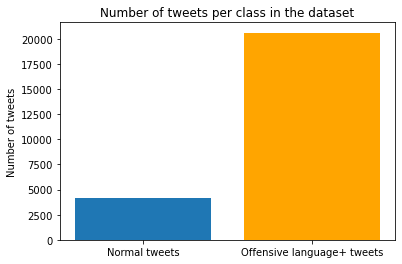

Normal Tweets: 4163
Offensive language+ Tweets: 20620


In [17]:
off_lang = df["grouped_class_descr"].value_counts()[0]
normal = df["grouped_class_descr"].value_counts()[1]

fig, ax = plt.subplots()
ax.set_title("Number of tweets per class in the dataset")
ax.bar("Normal tweets", normal)
ax.bar("Offensive language+ tweets", off_lang, color="orange")
ax.set_ylabel("Number of tweets")
plt.show()

print(f"Normal Tweets: {normal}")
print(f"Offensive language+ Tweets: {off_lang}")

### 3.1  Comparison - Wordcount, charactercount and average word length for normal and offensive language+ tweets
In this step I am going to calculate some basic statistics like word count or character count per tweet. This helps to get a basic understanding of the differences between tweets of both classes.

C:\Users\User\anaconda3\lib\site-packages\numpy\lib\histograms.py:839: RuntimeWarning: invalid value encountered in greater_equal
  keep = (tmp_a >= first_edge)
C:\Users\User\anaconda3\lib\site-packages\numpy\lib\histograms.py:840: RuntimeWarning: invalid value encountered in less_equal
  keep &= (tmp_a <= last_edge)


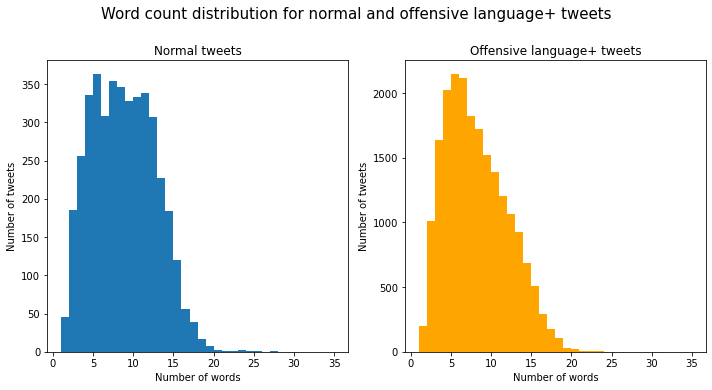

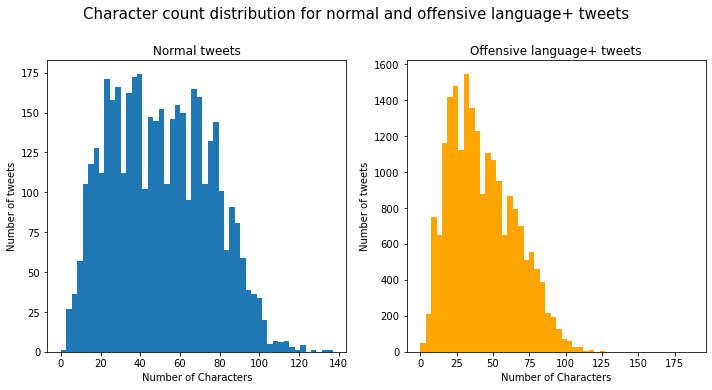

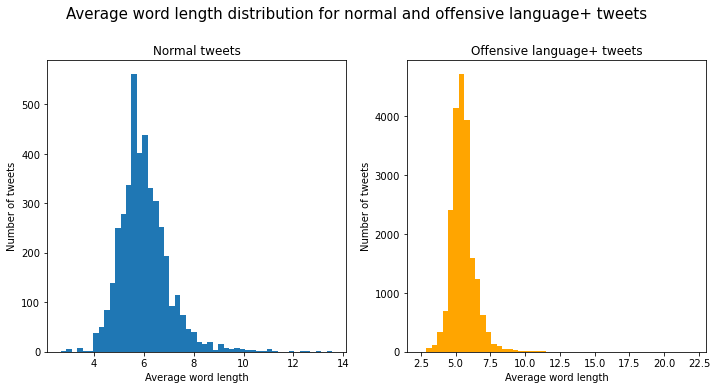

In [18]:
# Calculating word counts and character counts
def calc_avg_word_length(text):
    if len(text.split()) == 0:
        return None
    return len(text) / len(text.split())

df["text_length_words"] = df["tweet"].apply(lambda x: len(x.split()))
df["text_lenght_char"] = df["tweet"].apply(lambda x: len(x))
df["average_word_len"] = df["tweet"].apply(calc_avg_word_length)

# plotting word counts
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
fig.suptitle("Word count distribution for normal and offensive language+ tweets", fontsize=15, y = 1.075)
bins = np.linspace(1,35, 35, endpoint=True)

axes[0].hist(df[df["grouped_class_descr"] == "Normal"]["text_length_words"], bins)
axes[0].title.set_text('Normal tweets')
axes[0].set_xlabel("Number of words")
axes[0].set_ylabel("Number of tweets")

axes[1].hist(df[df["grouped_class_descr"] == "Offensive language+"]["text_length_words"], bins, color = "orange")
axes[1].title.set_text('Offensive language+ tweets')
axes[1].set_xlabel("Number of words")
axes[1].set_ylabel("Number of tweets")
fig.tight_layout()


# plotting character counts
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
fig.suptitle("Character count distribution for normal and offensive language+ tweets", fontsize=15, y = 1.075)
#bins = np.linspace(1,max(), 35, endpoint=True)

axes[0].hist(df[df["grouped_class_descr"] == "Normal"]["text_lenght_char"], 50)
axes[0].title.set_text('Normal tweets')
axes[0].set_xlabel("Number of Characters")
axes[0].set_ylabel("Number of tweets")

axes[1].hist(df[df["grouped_class_descr"] == "Offensive language+"]["text_lenght_char"], 50, color = "orange")
axes[1].title.set_text('Offensive language+ tweets')
axes[1].set_xlabel("Number of Characters")
axes[1].set_ylabel("Number of tweets")
fig.tight_layout()


# plotting Average word length
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
fig.suptitle("Average word length distribution for normal and offensive language+ tweets", fontsize=15, y = 1.075)
#bins = np.linspace(1,max(), 35, endpoint=True)

axes[0].hist(df[df["grouped_class_descr"] == "Normal"]["average_word_len"], 50)
axes[0].title.set_text('Normal tweets')
axes[0].set_xlabel("Average word length")
axes[0].set_ylabel("Number of tweets")

axes[1].hist(df[df["grouped_class_descr"] == "Offensive language+"]["average_word_len"], 50, color = "orange")
axes[1].title.set_text('Offensive language+ tweets')
axes[1].set_xlabel("Average word length")
axes[1].set_ylabel("Number of tweets")
fig.tight_layout()

In [19]:
print("Average number of words for normal tweets: ", df[df["grouped_class_descr"] == "Normal"]["text_length_words"].mean())
print("Average number of words for offensive language+ tweets: ", df[df["grouped_class_descr"] == "Offensive language+"]["text_length_words"].mean())
print("-"*45)
print("Average number of characters for normal tweets: ", df[df["grouped_class_descr"] == "Normal"]["text_lenght_char"].mean())
print("Average number of characters for offensive language+ tweets: ", df[df["grouped_class_descr"] == "Offensive language+"]["text_lenght_char"].mean())
print("-"*45)
print("Average word length for normal tweets: ", df[df["grouped_class_descr"] == "Normal"]["average_word_len"].mean())
print("Average word length for offensive language+ tweets: ", df[df["grouped_class_descr"] == "Offensive language+"]["average_word_len"].mean())
print("-"*45)

Average number of words for normal tweets:  8.336776363199615
Average number of words for offensive language+ tweets:  7.711833171677982
---------------------------------------------
Average number of characters for normal tweets:  50.31011289935143
Average number of characters for offensive language+ tweets:  42.86406401551891
---------------------------------------------
Average word length for normal tweets:  6.006517589061504
Average word length for offensive language+ tweets:  5.534017987125144
---------------------------------------------


In general tweets labeled as "Offensive language+" are a little bit shorter than normal tweets. But it is not a significant difference. Therefore it does not make sense to create any new feature with statistics like wordcount or tweetlength.

### 3.2 Wordcloud with most common words for each class
Wordclouds help to get a bsic understanding of the most commong words in tweets of both classes.

#### 3.2.1 Wordcloud normal tweets
The most common words in normal tweets are "trash", "bird" and "yellow". These words don't seem to be offensive in the first place.

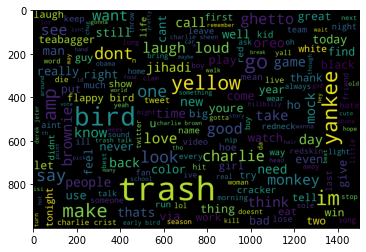

In [20]:
allwords = ' '.join([x for x in df[df["grouped_class_descr"] == "Normal"]["tweet"]])
Cloud = WordCloud(width=1500,height=1000,random_state=0,max_font_size=150).generate(allwords)

plt.imshow(Cloud)
plt.show()

#### 3.2.2 Wordcloud offensive language+ tweets
The most common words in normal tweets are "bitch", "hoe" and "pussy". These words seem to be quite offensive. We can clearly see the difference between normal and offensive language tweets.

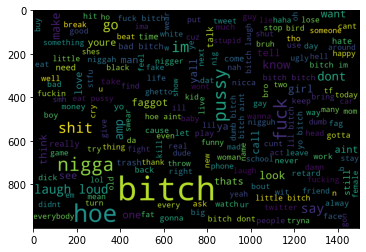

In [21]:
allwords = ' '.join([x for x in df[df["grouped_class_descr"] == "Offensive language+"]["tweet"]])
Cloud = WordCloud(width=1500,height=1000,random_state=0,max_font_size=150).generate(allwords)

plt.imshow(Cloud)
plt.show()

### 3.3 Sentiment Analysis
In this step I will use the library ``TextBlob`` to evaluate sentiment polarity and sentiment subjectivity for each tweet.

In [22]:
def tag_polarity(text):
    blob = TextBlob(text)
    return np.mean([sentence.polarity for sentence in blob.sentences])

def tag_subjectivity(text):
    blob = TextBlob(text)
    return np.mean([sentence.subjectivity for sentence in blob.sentences])

df["sentiment_polarity"] = df["tweet"].apply(tag_polarity)
df["sentiment_subjectivity"] = df["tweet"].apply(tag_subjectivity)

C:\Users\User\anaconda3\lib\site-packages\numpy\core\fromnumeric.py:3334: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,


<ipython-input-23-998de7eb6bba>:24: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  avg_polarity_normal_tweets = df_no_zero_polarity[df["grouped_class_descr"] == "Normal"]["sentiment_polarity"].mean()
<ipython-input-23-998de7eb6bba>:25: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  avg_polarity_off_tweets = df_no_zero_polarity[df["grouped_class_descr"] == "Offensive language+"]["sentiment_polarity"].mean()
<ipython-input-23-998de7eb6bba>:26: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  avg_subjectivity_normal_tweets = df_no_zero_subjectivity[df["grouped_class_descr"] == "Normal"]["sentiment_subjectivity"].mean()
<ipython-input-23-998de7eb6bba>:27: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  avg_subjectivity_off_tweets = df_no_zero_subjectivity[df["grouped_class_descr"] == "Offensive language+"]["sentiment_subjectivity"].mean()


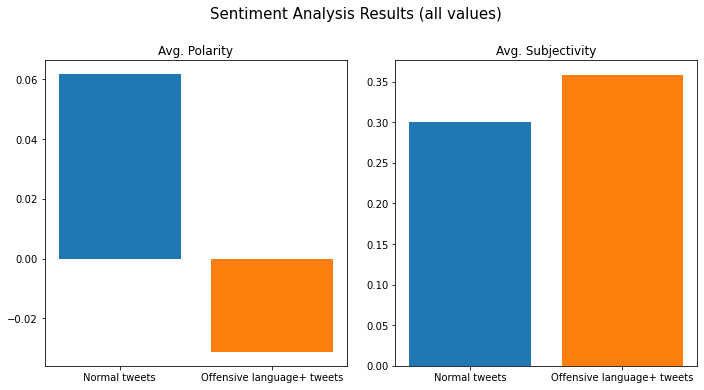

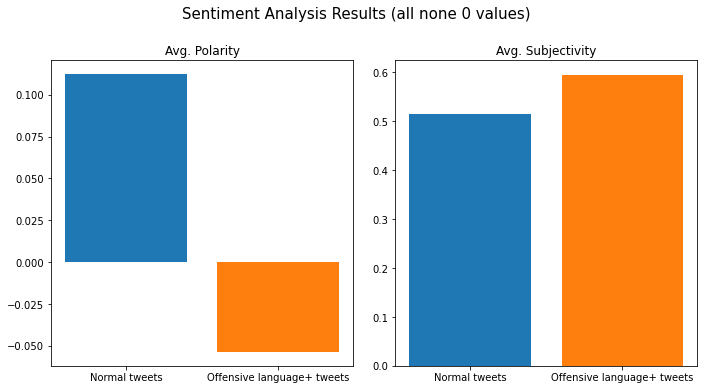

In [23]:
# All values
avg_polarity_normal_tweets = df[df["grouped_class_descr"] == "Normal"]["sentiment_polarity"].mean()
avg_polarity_off_tweets = df[df["grouped_class_descr"] == "Offensive language+"]["sentiment_polarity"].mean()
avg_subjectivity_normal_tweets = df[df["grouped_class_descr"] == "Normal"]["sentiment_subjectivity"].mean()
avg_subjectivity_off_tweets = df[df["grouped_class_descr"] == "Offensive language+"]["sentiment_subjectivity"].mean()

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
fig.suptitle("Sentiment Analysis Results (all values)", fontsize=15, y = 1.075)

axes[0].bar("Normal tweets", avg_polarity_normal_tweets)
axes[0].bar("Offensive language+ tweets", avg_polarity_off_tweets)
axes[0].title.set_text('Avg. Polarity')

axes[1].bar("Normal tweets", avg_subjectivity_normal_tweets)
axes[1].bar("Offensive language+ tweets", avg_subjectivity_off_tweets)
axes[1].title.set_text('Avg. Subjectivity')
fig.tight_layout()


# All none zero values
df_no_zero_polarity = df[~np.isclose(df['sentiment_polarity'], 0.0)]
df_no_zero_subjectivity = df[~np.isclose(df['sentiment_polarity'], 0.0)]

avg_polarity_normal_tweets = df_no_zero_polarity[df["grouped_class_descr"] == "Normal"]["sentiment_polarity"].mean()
avg_polarity_off_tweets = df_no_zero_polarity[df["grouped_class_descr"] == "Offensive language+"]["sentiment_polarity"].mean()
avg_subjectivity_normal_tweets = df_no_zero_subjectivity[df["grouped_class_descr"] == "Normal"]["sentiment_subjectivity"].mean()
avg_subjectivity_off_tweets = df_no_zero_subjectivity[df["grouped_class_descr"] == "Offensive language+"]["sentiment_subjectivity"].mean()

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(10, 5))
fig.suptitle("Sentiment Analysis Results (all none 0 values)", fontsize=15, y = 1.075)

axes[0].bar("Normal tweets", avg_polarity_normal_tweets)
axes[0].bar("Offensive language+ tweets", avg_polarity_off_tweets)
axes[0].title.set_text('Avg. Polarity')

axes[1].bar("Normal tweets", avg_subjectivity_normal_tweets)
axes[1].bar("Offensive language+ tweets", avg_subjectivity_off_tweets)
axes[1].title.set_text('Avg. Subjectivity')
fig.tight_layout()

It seems like the average sentiment polarity is clearly lower for offensive language+ tweets than for normal tweets. Therefore this will be a good feature for the machine learning models to work with. Meanwhile sentiment subjectivity does not make such a big difference in between normal tweets and tweets labeled as offensive language+

### 3.4 Text standard
I will use the ``textstat`` libraryto determine the textstandard for each tweet.

In [24]:
# quantify the text standard
def extract_textstandard_values(text):
    text = re.findall(r"-?\d{1,2}", text)
    return int(max(text))
    
df['text_standard']=df['tweet'].apply(lambda x: textstat.text_standard(x))
df["text_standard"] = df["text_standard"].apply(extract_textstandard_values)
df.head()

,count,hate_speech,offensive_language,neither,class,tweet,grouped_class_descr,grouped_class,deleted_text,text_length_words,text_lenght_char,average_word_len,sentiment_polarity,sentiment_subjectivity,text_standard
0,3,0,0,3,2,woman shouldnt complain cleaning house amp man...,Normal,0,"{'removed mentions': ['@mayasolovely'], 'remov...",10,64,6.400000,0.000,0.000000,4
1,3,0,3,0,1,boy dat coldtyga dwn bad cuffin dat hoe st place,Offensive language+,1,"{'removed mentions': ['@mleew17'], 'removed ha...",10,48,4.800000,-0.700,0.666667,4
2,3,0,3,0,1,dawg ever fuck bitch stato cry confuse shit,Offensive language+,1,"{'removed mentions': ['@urkindofbrand', '@80sb...",8,43,5.375000,-0.300,0.700000,4
3,3,0,2,1,1,ganderson base look like tranny,Offensive language+,1,"{'removed mentions': ['@c', '@viva'], 'removed...",5,31,6.200000,-0.800,1.000000,9
4,6,0,6,0,1,shit hear might true might faker bitch tell ya,Offensive language+,1,"{'removed mentions': ['@shenikaroberts'], 'rem...",9,46,5.111111,0.075,0.725000,4


In [25]:
df[df["grouped_class_descr"] == "Normal"]["text_standard"].mean()

5.6331972135479225

In [26]:
df[df["grouped_class_descr"] == "Normal"]["text_standard"].median()

5.0

In [27]:
df[df["grouped_class_descr"] == "Offensive language+"]["text_standard"].mean()

4.052376333656644

In [28]:
df[df["grouped_class_descr"] == "Offensive language+"]["text_standard"].median()

4.0

It seems like there is a difference in text standard between normal and offensive language+ tweets. Offensive language+ tweets tend to have a slightly lower text standard than normal tweets. Therefore I will also use this feature in the machine learning models.

### 3.5 Principal component analysis
To take a look at the data in 3D space I am going to use PCA to reduce the data to its most important features. By calculating the correlation between the original features and the principal components the chart can be interpreted.

In [29]:
# Initializing different vectorizers
count_vectorizer = CountVectorizer()
tf_idf_vectorizer = TfidfVectorizer()
hash_vectorizer = HashingVectorizer()

In [30]:
# creating word vectors
x_features =  count_vectorizer.fit_transform(df['tweet']).toarray()
y_classes  =  np.array(df["grouped_class"])

In [31]:
# creating Document-Term Matrix as a Dataframe
df_x_features = pd.DataFrame(x_features, columns=count_vectorizer.get_feature_names()).astype("int16")

In [32]:
# The two new features are "sentiment_polarity" and "text_standard"
sentiment_polarity = df["sentiment_polarity"]
text_standard = df["text_standard"]
tweet = df["tweet"]
labels = df["grouped_class"]

# Merging the two new features with the Document-Term Dataframe
df_x_features = df_x_features.merge(sentiment_polarity, left_index=True, right_index=True)
df_x_features = df_x_features.merge(text_standard, left_index=True, right_index=True)
df_x_features = df_x_features.merge(tweet, left_index=True, right_index=True)
df_x_features = df_x_features.merge(labels, left_index=True, right_index=True)

In [33]:
# Drop columns of tweet and class labels
df_x_features_mod = df_x_features.drop(columns=["tweet_y", "grouped_class"])

In [34]:
# Fill nan values with zero
df_x_features_mod.fillna(0, inplace = True)

In [35]:
# PCA with 3 principal components
pca = PCA(n_components=3, random_state=0)
reduced_features = pca.fit_transform(df_x_features_mod)

In [36]:
# Create a dataframe with the values of the 3 principal components
df_pca = pd.DataFrame(reduced_features, columns=["PC1", "PC2", "PC3"])
df_pca["Label"] = df_x_features["grouped_class"]

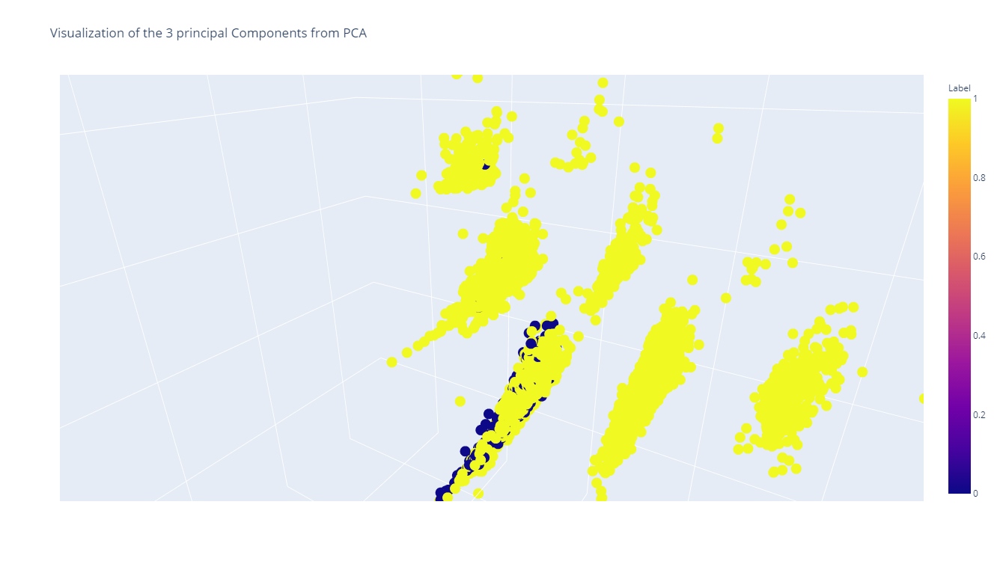

In [37]:
# Plot the values of the 3 principal components in 3D
fig = px.scatter_3d(df_pca, x='PC1', y='PC2', z='PC3', title="Visualization of the 3 principal Components from PCA", height = 750, 
                    color='Label', hover_data = {"Tweet": df_x_features["tweet_y"], 
                                               "Class": df_x_features["grouped_class"], 
                                               "sentiment_polarity": df_x_features["sentiment_polarity"],
                                              "Text Standard": df_x_features["text_standard"]})
fig.show(height = 2000, width = 1000)

In [38]:
# declaring principal components
pc1 = reduced_features[:,0]
pc2 = reduced_features[:,1]
pc3 = reduced_features[:,2]
pcs = [pc1, pc2, pc3]

In [39]:
# Calculating correlation beween each feature and the principal components
science_dict = dict()
for column in df_x_features_mod:
    corr_coeff = list()
    for pc in pcs:
        r,p = stats.pearsonr(pc, df_x_features_mod[column])
        corr_coeff.append(r)
    science_dict[column] = corr_coeff

In [41]:
# Creating Dataframe out of the dictionary in the cell above
df_pc_corr = pd.DataFrame(science_dict).T
df_pc_corr.rename(columns={0:"PC1",1:"PC2",2:"PC3"}, inplace = True)

In [42]:
# Show top 5 features that correlate most with each principal component
def highlight_cols(s):
    color = 'lightgreen'
    return 'background-color: %s' % color

df_pc_corr.reindex(df_pc_corr["PC1"].abs().sort_values(ascending=False).index)[:5].style.applymap(highlight_cols, subset=["PC1"])

,PC1,PC2,PC3
text_standard,0.999997,0.001444,0.001000
projectdrugsampbitches,0.142128,0.003109,0.005612
gtgtgtgtgtgtgtgtgtgtgtgtgtgtgtgtgtgtgt,0.115009,0.011901,0.007302
jihadi,0.095306,-0.023582,-0.029715
bitch,-0.084587,0.971482,0.160538


In [43]:
df_pc_corr.reindex(df_pc_corr["PC2"].abs().sort_values(ascending=False).index)[:5].style.applymap(highlight_cols, subset=["PC2"])

,PC1,PC2,PC3
bitch,-0.084587,0.971482,0.160538
hoe,-0.082163,-0.460882,0.842411
pussy,-0.018613,-0.196010,-0.314775
trash,0.032267,-0.147594,-0.182787
sentiment_polarity,0.026111,-0.136756,-0.067091


In [44]:
df_pc_corr.reindex(df_pc_corr["PC3"].abs().sort_values(ascending=False).index)[:5].style.applymap(highlight_cols, subset=["PC3"])

,PC1,PC2,PC3
hoe,-0.082163,-0.460882,0.842411
pussy,-0.018613,-0.196010,-0.314775
get,0.028644,0.061625,0.273353
nigga,0.054836,0.098447,0.203403
trash,0.032267,-0.147594,-0.182787


**Interpretation of the principal component analysis:** <br>
Principal component 1 correlates nearly 100% with the original feature Text standard. That means the higher PC1 is the higher the text standard of the tweet. PC2 and PC3 both have strong correlation with words that are very typical for offensive language. That means if PC2 or PC3 has either a very heigh value or a very low value it usually contain lots of offensive words. It can clearly be seen that the normal tweets are located in the middle of the graph where both PC2 and PC3 are very low meaning they don't contain any offensive words.

### 3.6 Clustering
It is always intersting to take a look at how a clustering algorithm would label the data. This is what I am going to do in this section with the K-means clustering algorithm. I am going to use the data from the PCA to cluster the data.

In [45]:
# clustering K-Means
model = KMeans(n_clusters = 2)
model.fit(reduced_features)

KMeans(n_clusters=2)

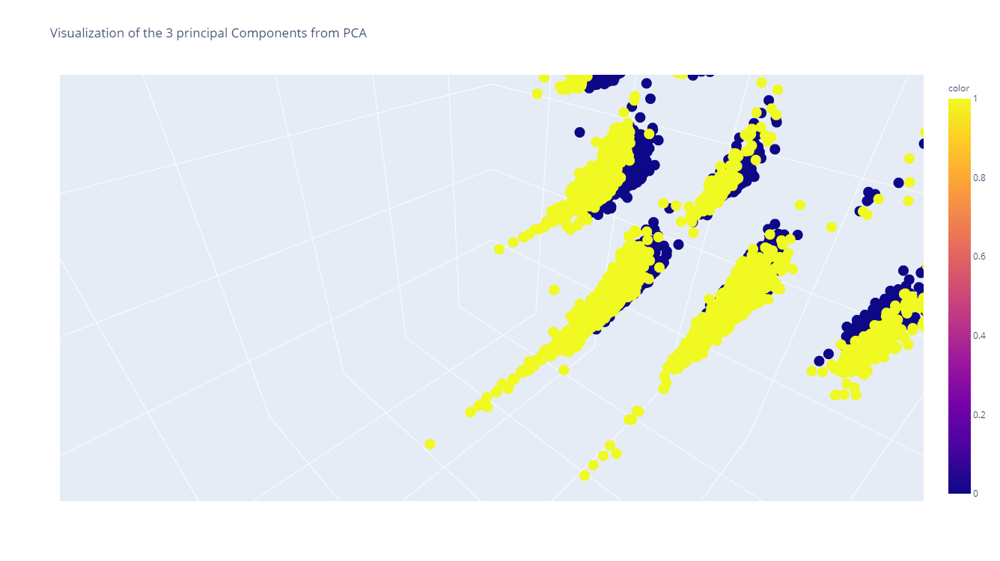

In [46]:
# Plot the clustered data in 3D space
fig = px.scatter_3d(df_pca, x='PC1', y='PC2', z='PC3', title="Visualization of the 3 principal Components from PCA", height = 750, 
                    color=model.labels_, hover_data = {"Tweet": df_x_features["tweet_y"], 
                                               "Class": df_x_features["grouped_class"], 
                                               "sentiment_polarity": df_x_features["sentiment_polarity"],
                                              "Text Standard": df_x_features["text_standard"]})
fig.show(height = 2000, width = 1000)

It seems like the k-means algorithm simply clusters the data based on the text standard. This makes sense because the algorithm focuses on global distances instead of local distances. And since the text standard is the feature with the most variability, it makes sense to split the data based on this feature. It is obvious that this is not the right algorithm for clustering this perticular dataset. 

### 3.7 TSNE


In [47]:
X_embedded = TSNE(n_components=3)
reduced_features = X_embedded.fit_transform(df_x_features_mod)

In [48]:
X_embedded.shape

In [49]:
reduced_features

In [54]:
# Create a dataframe with the values of the 3 principal components
df_tsne = pd.DataFrame(reduced_features, columns=["PC1", "PC2", "PC3"])
df_tsne["Label"] = df_x_features["grouped_class"]

In [ ]:
# Plot the values of the 3 principal components in 3D
fig = px.scatter_3d(df_tsne, x='PC1', y='PC2', z='PC3', title="Visualization of the 3 principal Components from PCA", height = 750, 
                    color='Label', hover_data = {"Tweet": df_x_features["tweet_y"], 
                                               "Class": df_x_features["grouped_class"], 
                                               "sentiment_polarity": df_x_features["sentiment_polarity"],
                                              "Text Standard": df_x_features["text_standard"]})
fig.show(height = 2000, width = 1000)

In [38]:
# declaring principal components
pc1 = reduced_features[:,0]
pc2 = reduced_features[:,1]
pc3 = reduced_features[:,2]
pcs = [pc1, pc2, pc3]

In [39]:
# Calculating correlation beween each feature and the principal components
science_dict = dict()
for column in df_x_features_mod:
    corr_coeff = list()
    for pc in pcs:
        r,p = stats.pearsonr(pc, df_x_features_mod[column])
        corr_coeff.append(r)
    science_dict[column] = corr_coeff

In [41]:
# Creating Dataframe out of the dictionary in the cell above
df_pc_corr = pd.DataFrame(science_dict).T
df_pc_corr.rename(columns={0:"PC1",1:"PC2",2:"PC3"}, inplace = True)

In [42]:
# Show top 5 features that correlate most with each principal component
def highlight_cols(s):
    color = 'lightgreen'
    return 'background-color: %s' % color

df_pc_corr.reindex(df_pc_corr["PC1"].abs().sort_values(ascending=False).index)[:5].style.applymap(highlight_cols, subset=["PC1"])

,PC1,PC2,PC3
text_standard,0.999997,0.001444,0.001000
projectdrugsampbitches,0.142128,0.003109,0.005612
gtgtgtgtgtgtgtgtgtgtgtgtgtgtgtgtgtgtgt,0.115009,0.011901,0.007302
jihadi,0.095306,-0.023582,-0.029715
bitch,-0.084587,0.971482,0.160538


In [43]:
df_pc_corr.reindex(df_pc_corr["PC2"].abs().sort_values(ascending=False).index)[:5].style.applymap(highlight_cols, subset=["PC2"])

,PC1,PC2,PC3
bitch,-0.084587,0.971482,0.160538
hoe,-0.082163,-0.460882,0.842411
pussy,-0.018613,-0.196010,-0.314775
trash,0.032267,-0.147594,-0.182787
sentiment_polarity,0.026111,-0.136756,-0.067091


In [44]:
df_pc_corr.reindex(df_pc_corr["PC3"].abs().sort_values(ascending=False).index)[:5].style.applymap(highlight_cols, subset=["PC3"])

,PC1,PC2,PC3
hoe,-0.082163,-0.460882,0.842411
pussy,-0.018613,-0.196010,-0.314775
get,0.028644,0.061625,0.273353
nigga,0.054836,0.098447,0.203403
trash,0.032267,-0.147594,-0.182787
